# 09 APIs and STAC Catalogs demo

UW Geospatial Data Analysis  
CEE467/CEWA567  
David Shean, Eric Gagliano, Quinn Brencher

## Overview

In this notebook, we'll explore:
1. What are web APIs and why they matter for geospatial data
2. Introduction to STAC (SpatioTemporal Asset Catalog) standard
3. Accessing Microsoft's Planetary Computer STAC API
4. Loading and visualizing Sentinel-2 imagery using ODC STAC

## 1. Introduction to APIs

APIs (Application Programming Interfaces) are mechanisms that enable us to access data and services over the internet.

Key concepts:
- **Endpoints**: URLs that accept requests and return responses
- **HTTP Methods**: GET, POST, PUT, DELETE for different operations
- **Request Parameters**: Information sent to the API
- **Response Format**: Typically JSON or XML

### Anatomy of an API Request

Let's look at the anatomy of an API request using the Open-Meteo example we'll implement below:

```
https://api.open-meteo.com/v1/forecast?latitude=47.6&longitude=-122.3&current_weather=true
```

What does each part of this API request mean??

1. **Base URL**: The root address of the API
   - `https://api.open-meteo.com`

2. **Path**: Specifies the resource or service being accessed
   - `/v1/forecast`

3. **Query Parameters**: Key-value pairs appended to the URL after a question mark
   - `latitude=47.6` (Seattle's latitude)
   - `longitude=-122.3` (Seattle's longitude)
   - `current_weather=true` (requesting current weather data)
   - Multiple parameters are separated by ampersands (`&`)

This doesn't include all potential parts of API requests, headers, request body, authentication (api keys, etc), and path parameters aren't shown in this example


### API Responses

After sending a request, you'll receive a response. Let's look at what's included in the Open-Meteo response:

1. **Status Codes**: Indicate the result of the request
   - 200: OK (Success) - What we got from Open-Meteo
   - 201: Created (for successful POST requests)
   - 400: Bad Request (if we provided invalid parameters)
   - 401: Unauthorized (if authentication failed)
   - 404: Not Found (if the endpoint doesn't exist)
   - 500: Internal Server Error (if the server had an error)

2. **Response Body**: The data returned by the API
   - Our Open-Meteo response is in JSON format
   - Contains:
     - `current_weather` object with temperature, wind speed, etc.
     - Metadata like latitude, longitude, elevation
     - Time information

3. **Response Structure Example** (simplified from Open-Meteo):
```json
{
  "latitude": 47.6,
  "longitude": -122.3,
  "generationtime_ms": 0.2510547637939453,
  "utc_offset_seconds": 0,
  "timezone": "GMT",
  "timezone_abbreviation": "GMT",
  "elevation": 74.0,
  "current_weather": {
    "temperature": 12.6,
    "windspeed": 8.1,
    "winddirection": 262.0,
    "weathercode": 3,
    "time": "2023-04-21T12:00"
  }
}
```

For geospatial applications, APIs provide:
- Access to vast repositories of data without downloading
- Real-time or near-real-time data access
- Standardized interfaces to diverse data sources
- Ability to perform server-side filtering and process


### See how an API request changes depending on what you're asking for...
Check out the [open-meteo documentation](https://open-meteo.com/en/docs). Scroll down to right underneath the chart and take note of the API url and its parameters. Now scroll back up, change the selections, and scroll back down to see how the url has changed.

### Here's an example of a basic API request using the requests library: We'll send an API request to Open-Meteo's API, an open source weather data provider

In [1]:
# very common to use requests library for making HTTP requests
import requests

In [2]:
# notice that the response says 200 -- what does this mean again?
response = requests.get("https://api.open-meteo.com/v1/forecast?latitude=47.6&longitude=-122.3&current_weather=true")
response

<Response [200]>

In [3]:
# what does the reponse look like? follow the url!
response.request.url

'https://api.open-meteo.com/v1/forecast?latitude=47.6&longitude=-122.3&current_weather=true'

In [4]:
# now we'll want to use the .json() method to get the data
data = response.json()
data

{'latitude': 47.60265,
 'longitude': -122.28637,
 'generationtime_ms': 0.06330013275146484,
 'utc_offset_seconds': 0,
 'timezone': 'GMT',
 'timezone_abbreviation': 'GMT',
 'elevation': 93.0,
 'current_weather_units': {'time': 'iso8601',
  'interval': 'seconds',
  'temperature': '°C',
  'windspeed': 'km/h',
  'winddirection': '°',
  'is_day': '',
  'weathercode': 'wmo code'},
 'current_weather': {'time': '2025-03-03T09:30',
  'interval': 900,
  'temperature': 8.0,
  'windspeed': 3.3,
  'winddirection': 347,
  'is_day': 0,
  'weathercode': 3}}

In [5]:
# Display the results
print(f"Temperature in Seattle: {data['current_weather']['temperature']}°C")
print(f"Wind speed: {data['current_weather']['windspeed']} km/h")

Temperature in Seattle: 8.0°C
Wind speed: 3.3 km/h


### What if we tried with an invalid request?

In [6]:
try:
    # Bad request with invalid parameters
    bad_response = requests.get("https://api.open-meteo.com/v1/forecast?latitude=999&longitude=-999")
    
    # Check if the request was successful
    bad_response.raise_for_status()  
    
except requests.exceptions.HTTPError as err:
    print(f"HTTP Error occurred: {err}")
    print(f"Response body: {bad_response.text}")

HTTP Error occurred: 400 Client Error: Bad Request for url: https://api.open-meteo.com/v1/forecast?latitude=999&longitude=-999
Response body: {"reason":"Latitude must be in range of -90 to 90°. Given: 999.0.","error":true}


## 2. STAC (SpatioTemporal Asset Catalog)

### RESTful APIs and STAC

REST (Representational State Transfer) is an architectural style for designing networked applications. Key principles include:

- **Resource-Based**: Everything is identified by a unique URL
- **Standard HTTP Methods**: GET (retrieve), POST (create), PUT/PATCH (update), DELETE (remove)  
- **Stateless**: Each request contains all information needed
- **Uniform Interface**: Consistent ways to interact with resources

[STAC](https://stacspec.org/en) (SpatioTemporal Asset Catalog) is an open specification that implements RESTful principles to standardize how geospatial data is made available online. 


### Key STAC Concepts:

- **STAC Item**: Metadata for a single spatial asset (e.g., a satellite image)
- **STAC Collection**: Group of related STAC Items
- **STAC Catalog**: Container for Collections and/or Items
- **STAC API**: RESTful API that provides search and discovery of STAC Items

STAC standardizes metadata about:
- Spatial extent
- Temporal information
- Data properties (bands, cloud cover, etc.)
- Links to actual data

Benefits of STAC:

- Consistent way to search across different data providers
- Machine-readable metadata
- Self-describing data
- Interoperability between different platforms

### Microsoft Planetary Computer and STAC

Microsoft's Planetary Computer is one of many platforms that host a variety of Earth observation datasets accompanied by a STAC catalog to access them. Check out [Reading Data from the STAC API
](https://planetarycomputer.microsoft.com/docs/quickstarts/reading-stac/) for more info. We'll be looking at their [Sentinel-2 dataset](https://planetarycomputer.microsoft.com/dataset/sentinel-2-l2a#overview) for the rest of this demo.

### Let's try to access Microsoft Planetary Computer's Sentinel-2 STAC catalog
#### We'll use [pystac_client](https://pystac-client.readthedocs.io/en/stable/) to open the STAC catalog

In [7]:
import pystac_client
import planetary_computer

In [8]:
catalog = pystac_client.Client.open(
    "https://planetarycomputer.microsoft.com/api/stac/v1",
    modifier=planetary_computer.sign_inplace,
)

#catalog = pystac_client.Client.open("https://earth-search.aws.element84.com/v1/") #another catalog option for Sentinel-2
catalog

<Client id=microsoft-pc>

#### Now we'll search the catalog with a date range and region of interest...

In [9]:
import geopandas as gpd

In [10]:
start_date = "2024-07-15"
end_date = "2024-07-15"
states_gdf = gpd.read_file('http://eric.clst.org/assets/wiki/uploads/Stuff/gz_2010_us_040_00_5m.json')
wa_gdf = states_gdf[states_gdf['NAME'] == 'Washington']
bbox = wa_gdf.total_bounds
bbox

array([-124.733174,   45.543541, -116.915989,   49.002494])

In [11]:
search = catalog.search(
    collections=["sentinel-2-l2a"], # sentinel-2-c1-l2a if using earthsearch
    bbox=bbox,
    datetime=(start_date, end_date), 
    #query={"eo:cloud_cover": {"lt": 30}},
)

#### Check out the items returned by the search!

In [12]:
items = search.item_collection()
items

In [13]:
if items:
    item = items[0]
    print(f"Item ID: {item.id}")
    print(f"Datetime: {item.datetime.strftime('%Y-%m-%d')}")
    print(f"Cloud cover: {item.properties['eo:cloud_cover']}%")
    
    # List available assets (different bands and products)
    print("\nAvailable assets:")
    for asset_key, asset in item.assets.items():
        print(f"- {asset_key}: {asset.title if hasattr(asset, 'title') else ''}")

Item ID: S2A_MSIL2A_20240715T185921_R013_T11UMQ_20240716T032503
Datetime: 2024-07-15
Cloud cover: 3.178876%

Available assets:
- AOT: Aerosol optical thickness (AOT)
- B01: Band 1 - Coastal aerosol - 60m
- B02: Band 2 - Blue - 10m
- B03: Band 3 - Green - 10m
- B04: Band 4 - Red - 10m
- B05: Band 5 - Vegetation red edge 1 - 20m
- B06: Band 6 - Vegetation red edge 2 - 20m
- B07: Band 7 - Vegetation red edge 3 - 20m
- B08: Band 8 - NIR - 10m
- B09: Band 9 - Water vapor - 60m
- B11: Band 11 - SWIR (1.6) - 20m
- B12: Band 12 - SWIR (2.2) - 20m
- B8A: Band 8A - Vegetation red edge 4 - 20m
- SCL: Scene classfication map (SCL)
- WVP: Water vapour (WVP)
- visual: True color image
- preview: Thumbnail
- safe-manifest: SAFE manifest
- granule-metadata: Granule metadata
- inspire-metadata: INSPIRE metadata
- product-metadata: Product metadata
- datastrip-metadata: Datastrip metadata
- tilejson: TileJSON with default rendering
- rendered_preview: Rendered preview


#### Now lets turn these items into a geodataframe for more familiar visualization

In [14]:
import matplotlib.pyplot as plt
import contextily as ctx

In [15]:
stac_json = search.item_collection_as_dict()
metadata_gdf = gpd.GeoDataFrame.from_features(stac_json, "epsg:4326")
metadata_gdf

,geometry,datetime,platform,proj:epsg,instruments,s2:mgrs_tile,constellation,s2:granule_id,eo:cloud_cover,s2:datatake_id,...,s2:cloud_shadow_percentage,s2:nodata_pixel_percentage,s2:unclassified_percentage,s2:dark_features_percentage,s2:not_vegetated_percentage,s2:degraded_msi_data_percentage,s2:high_proba_clouds_percentage,s2:reflectance_conversion_factor,s2:medium_proba_clouds_percentage,s2:saturated_defective_pixel_percentage
0,"POLYGON ((-117.87227 49.6472, -117.8839 49.621...",2024-07-15T18:59:21.024000Z,Sentinel-2A,32611,[msi],11UMQ,Sentinel 2,S2A_OPER_MSI_L2A_TL_MSFT_20240716T032504_A0473...,3.178876,GS2A_20240715T185921_047343_N05.10,...,2.043696,82.493359,0.283331,2.020537,6.179187,0.0002,1.948861,0.967614,1.171530,0.0
1,"POLYGON ((-118.29888 48.74531, -118.3575 48.61...",2024-07-15T18:59:21.024000Z,Sentinel-2A,32611,[msi],11UMP,Sentinel 2,S2A_OPER_MSI_L2A_TL_MSFT_20240716T031349_A0473...,0.000000,GS2A_20240715T185921_047343_N05.10,...,0.000000,99.744135,0.040198,1.613112,5.027361,0.0000,0.000000,0.967614,0.000000,0.0
2,"POLYGON ((-118.2306 48.8888, -118.2949 48.7539...",2024-07-15T18:59:21.024000Z,Sentinel-2A,32611,[msi],11ULQ,Sentinel 2,S2A_OPER_MSI_L2A_TL_MSFT_20240716T032531_A0473...,1.359492,GS2A_20240715T185921_047343_N05.10,...,0.745373,0.920103,0.218757,0.526810,20.684105,0.0223,0.774191,0.967614,0.562098,0.0
3,"POLYGON ((-118.29891 48.74525, -118.36187 48.6...",2024-07-15T18:59:21.024000Z,Sentinel-2A,32611,[msi],11ULP,Sentinel 2,S2A_OPER_MSI_L2A_TL_MSFT_20240716T032146_A0473...,0.902603,GS2A_20240715T185921_047343_N05.10,...,0.001136,21.167192,0.121392,0.525987,57.613897,0.0282,0.000960,0.967614,0.009066,0.0
4,"POLYGON ((-118.71336 47.83879, -118.75771 47.7...",2024-07-15T18:59:21.024000Z,Sentinel-2A,32611,[msi],11TLN,Sentinel 2,S2A_OPER_MSI_L2A_TL_MSFT_20240716T032831_A0473...,0.001157,GS2A_20240715T185921_047343_N05.10,...,0.000000,50.961173,0.411384,0.167276,78.942764,0.0172,0.000041,0.967614,0.000852,0.0
5,"POLYGON ((-119.11501 46.93209, -119.14232 46.8...",2024-07-15T18:59:21.024000Z,Sentinel-2A,32611,[msi],11TLM,Sentinel 2,S2A_OPER_MSI_L2A_TL_MSFT_20240716T031743_A0473...,0.005342,GS2A_20240715T185921_047343_N05.10,...,0.000434,80.869365,0.277073,0.043462,78.576916,0.0005,0.000572,0.967614,0.004769,0.0
6,"POLYGON ((-119.50484 46.02565, -119.51643 45.9...",2024-07-15T18:59:21.024000Z,Sentinel-2A,32611,[msi],11TLL,Sentinel 2,S2A_OPER_MSI_L2A_TL_MSFT_20240716T032212_A0473...,0.599712,GS2A_20240715T185921_047343_N05.10,...,0.086370,99.523664,1.069172,0.005572,49.781638,0.0002,0.080797,0.967614,0.518914,0.0
7,"POLYGON ((-120.23149 49.61961, -118.71495 49.5...",2024-07-15T18:59:21.024000Z,Sentinel-2A,32610,[msi],10UGV,Sentinel 2,S2A_OPER_MSI_L2A_TL_MSFT_20240716T033930_A0473...,0.271821,GS2A_20240715T185921_047343_N05.10,...,0.198596,0.000000,0.154555,0.748641,27.691483,0.0201,0.116254,0.967614,0.154615,0.0
8,"POLYGON ((-120.28118 48.72093, -118.79172 48.6...",2024-07-15T18:59:21.024000Z,Sentinel-2A,32610,[msi],10UGU,Sentinel 2,S2A_OPER_MSI_L2A_TL_MSFT_20240716T033602_A0473...,0.922678,GS2A_20240715T185921_047343_N05.10,...,0.027017,0.000000,0.138891,0.323131,64.844561,0.0217,0.009847,0.967614,0.028119,0.0
9,"POLYGON ((-121.61483 49.64444, -120.09543 49.6...",2024-07-15T18:59:21.024000Z,Sentinel-2A,32610,[msi],10UFV,Sentinel 2,S2A_OPER_MSI_L2A_TL_MSFT_20240716T033914_A0473...,0.000319,GS2A_20240715T185921_047343_N05.10,...,0.000000,0.000007,0.060484,1.580960,14.125817,0.0000,0.000007,0.967614,0.000229,0.0


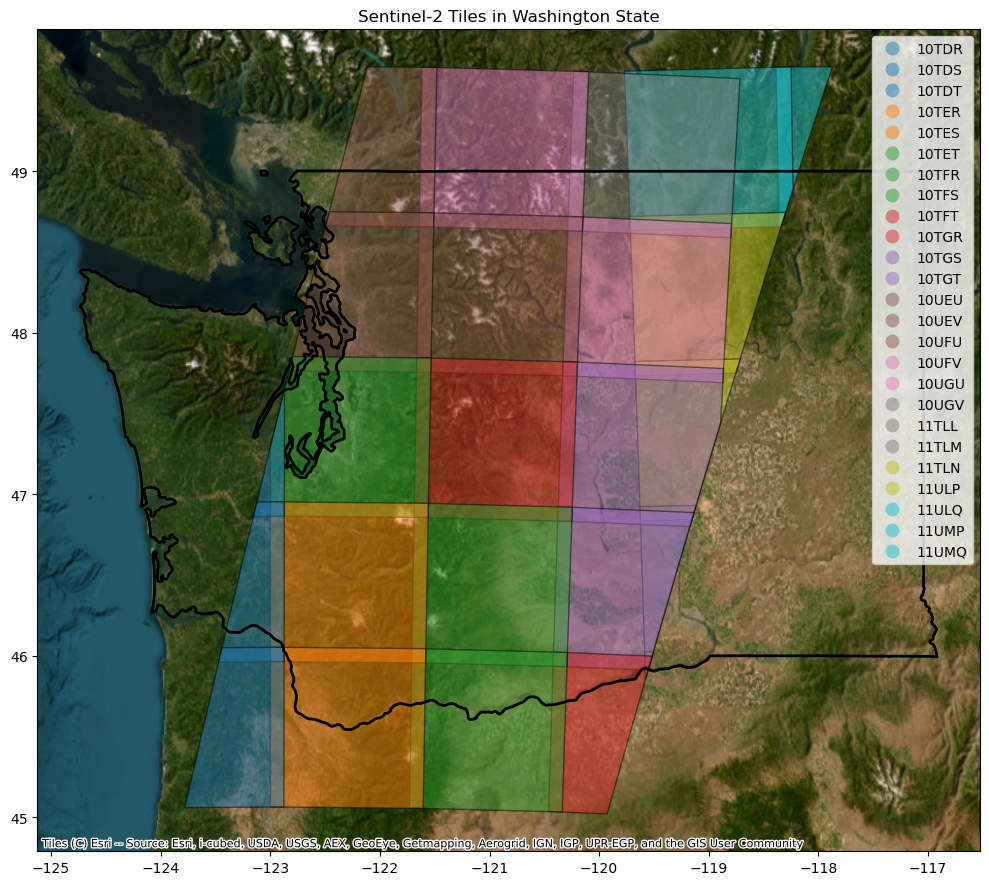

In [16]:
f, ax = plt.subplots(figsize=(10,10))

metadata_gdf.plot(
    ax=ax, 
    column="s2:mgrs_tile", # "s2:tile_id" for earthsearch
    categorical=True, 
    legend=True, 
    alpha=0.5, 
    edgecolor="k",
)

wa_gdf.boundary.plot(ax=ax, color="black", linewidth=2)

ctx.add_basemap(ax, crs=metadata_gdf.crs, source=ctx.providers.Esri.WorldImagery)

ax.set_title("Sentinel-2 Tiles in Washington State")

f.tight_layout()

In [17]:
# metadata_gdf.explore("s2:granule_id",
#                      categorical=True,
# )

## 3. Loading Sentinel-2 Imagery with [odc-stac]((https://odc-stac.readthedocs.io/))
### Let's search the STAC catalog for a smaller area with a longer time range--we'll focus again on Mt. Rainier throughout July 2024

In [18]:
import odc.stac
import rioxarray

In [19]:
start_date = "2024-07-01"
end_date = "2024-07-31"

rainier_bbox_gdf = gpd.read_file("https://github.com/egagli/easysnowdata/raw/main/docs/examples/mt_rainier.geojson")
bbox = rainier_bbox_gdf.total_bounds
bbox

array([-121.94224976,   46.72842173, -121.54136001,   46.99728203])

In [20]:
search = catalog.search(
    collections=["sentinel-2-l2a"], # sentinel-2-c1-l2a if using earthsearch
    bbox=bbox,
    datetime=(start_date, end_date), 
    #query={"eo:cloud_cover": {"lt": 30}},
)

items = search.item_collection()
items

### Now we'll load the items into a lazily loaded xarray dataset

In [21]:
bands = ["B02", "B03", "B04", "B08"]  # Blue, Green, Red, NIR

s2_ds = odc.stac.load(items,
                      #bands=bands, # you can specify bands here if you'd like, 
                      # but since we are using lazy loading, we won't take a performance hit 
                      # includind all bands unless we need them for a calculation
                      #chunks={"x": 256, "y": 256},
                      resolution=80,
                      chunks={},
                      groupby='solar_day',
                      bbox=bbox,
)

s2_ds

<xarray.Dataset> Size: 114MB
Dimensions:      (y: 380, x: 389, time: 12)
Coordinates:
  * y            (y) float64 3kB 5.206e+06 5.206e+06 ... 5.176e+06 5.176e+06
  * x            (x) float64 3kB 5.804e+05 5.805e+05 ... 6.114e+05 6.115e+05
    spatial_ref  int32 4B 32610
  * time         (time) datetime64[ns] 96B 2024-07-03T19:09:19.024000 ... 202...
Data variables: (12/16)
    AOT          (time, y, x) float32 7MB dask.array<chunksize=(1, 380, 389), meta=np.ndarray>
    B01          (time, y, x) float32 7MB dask.array<chunksize=(1, 380, 389), meta=np.ndarray>
    B02          (time, y, x) float32 7MB dask.array<chunksize=(1, 380, 389), meta=np.ndarray>
    B03          (time, y, x) float32 7MB dask.array<chunksize=(1, 380, 389), meta=np.ndarray>
    B04          (time, y, x) float32 7MB dask.array<chunksize=(1, 380, 389), meta=np.ndarray>
    B05          (time, y, x) float32 7MB dask.array<chunksize=(1, 380, 389), meta=np.ndarray>
    ...           ...
    B11          (time, y, x) float32 7MB dask.array<chunksize=(1, 380, 389), meta=np.ndarray>
    B12          (time, y, x) float32 7MB dask.array<chunksize=(1, 380, 389), meta=np.ndarray>
    B8A          (time, y, x) float32 7MB dask.array<chunksize=(1, 380, 389), meta=np.ndarray>
    SCL          (time, y, x) float32 7MB dask.array<chunksize=(1, 380, 389), meta=np.ndarray>
    WVP          (time, y, x) float32 7MB dask.array<chunksize=(1, 380, 389), meta=np.ndarray>
    visual       (time, y, x) float32 7MB dask.array<chunksize=(1, 380, 389), meta=np.ndarray>

### Try a rough RGB composite time-series!

In [22]:
rgb_da = s2_ds[["B04", "B03", "B02"]].to_array(dim='band').compute() # What do you think compute does here?
rgb_da

/home/eric/miniconda3/envs/uwgda2025/lib/python3.12/site-packages/rasterio/warp.py:387: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dest = _reproject(


<xarray.DataArray (band: 3, time: 12, y: 380, x: 389)> Size: 21MB
array([[[[ 1418.,  1736.,  1470., ...,    nan,    nan,    nan],
         [ 1171.,  1415.,  1284., ...,    nan,    nan,    nan],
         [ 1312.,  1520.,  1125., ...,    nan,    nan,    nan],
         ...,
         [ 1274.,  1237.,  1250., ...,    nan,    nan,    nan],
         [ 1108.,  1140.,  1139., ...,    nan,    nan,    nan],
         [ 1161.,  1121.,  1116., ...,    nan,    nan,    nan]],

        [[ 1428.,  1507.,  1472., ...,  1178.,  1213.,  1261.],
         [ 1335.,  1269.,  1185., ...,  1192.,  1070.,  1632.],
         [ 1143.,  1173.,  1134., ...,  1153.,  1072.,  1956.],
         ...,
         [ 1305.,  1256.,  1285., ...,  1185.,  1216.,  1256.],
         [ 1153.,  1173.,  1165., ...,  1211.,  1334.,  1233.],
         [ 1199.,  1144.,  1147., ...,  1305.,  1341.,  1370.]],

        [[ 1383.,  1424.,  1390., ...,    nan,    nan,    nan],
         [ 1295.,  1238.,  1155., ...,    nan,    nan,    nan],
         [ 1111.,  1135.,  1104., ...,    nan,    nan,    nan],
         ...,
...
         [ 7645.,  7786.,  7224., ..., 13165., 13244., 13690.],
         [ 7044.,  7070.,  5597., ..., 13576., 13199., 12536.],
         [ 6430.,  5693.,  5819., ..., 13065., 12393., 12398.]],

        [[ 1348.,  1391.,  1365., ...,    nan,    nan,    nan],
         [ 1321.,  1263.,  1236., ...,    nan,    nan,    nan],
         [ 1194.,  1202.,  1182., ...,    nan,    nan,    nan],
         ...,
         [ 1224.,  1185.,  1196., ...,    nan,    nan,    nan],
         [ 1213.,  1269.,  1217., ...,    nan,    nan,    nan],
         [ 1220.,  1176.,  1201., ...,    nan,    nan,    nan]],

        [[10509., 10432., 10241., ...,  5463.,  5112.,  5355.],
         [10578., 10403., 10128., ...,  6485.,  6905.,  6594.],
         [10090.,  9916.,  9837., ...,  9362.,  8993.,  8220.],
         ...,
         [ 5819.,  5637.,  5652., ...,  8536.,  8537.,  8094.],
         [ 4827.,  5094.,  4970., ...,  8827.,  8750.,  8499.],
         [ 4971.,  4684.,  4528., ...,  9035.,  8831.,  8816.]]]],
      dtype=float32)
Coordinates:
  * y            (y) float64 3kB 5.206e+06 5.206e+06 ... 5.176e+06 5.176e+06
  * x            (x) float64 3kB 5.804e+05 5.805e+05 ... 6.114e+05 6.115e+05
    spatial_ref  int32 4B 32610
  * time         (time) datetime64[ns] 96B 2024-07-03T19:09:19.024000 ... 202...
  * band         (band) object 24B 'B04' 'B03' 'B02'

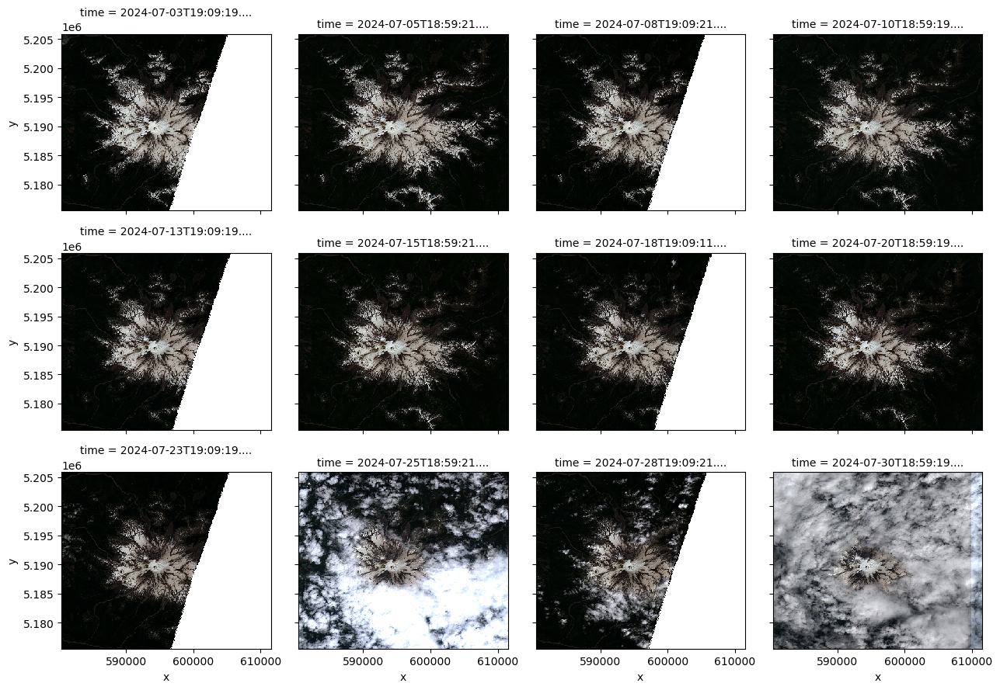

In [23]:
rgb_da.plot.imshow(col='time',col_wrap=4,robust=True)

### Plot a median RGB image for July 2024

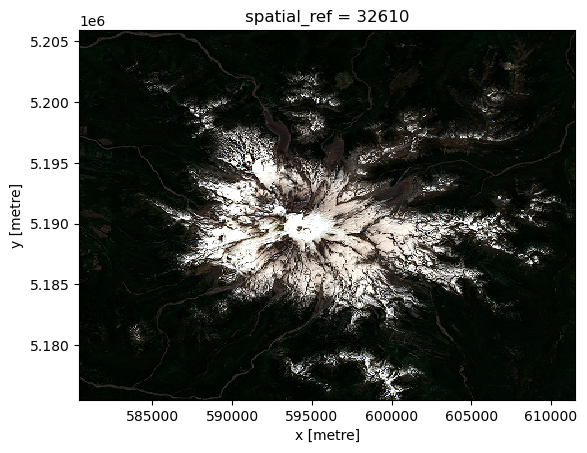

In [24]:
rgb_da.median(dim='time').plot.imshow(robust=True)

### How can we tell when and where there are clouds?
Check out the scene classification layer, [SCL](https://custom-scripts.sentinel-hub.com/custom-scripts/sentinel-2/scene-classification/)!

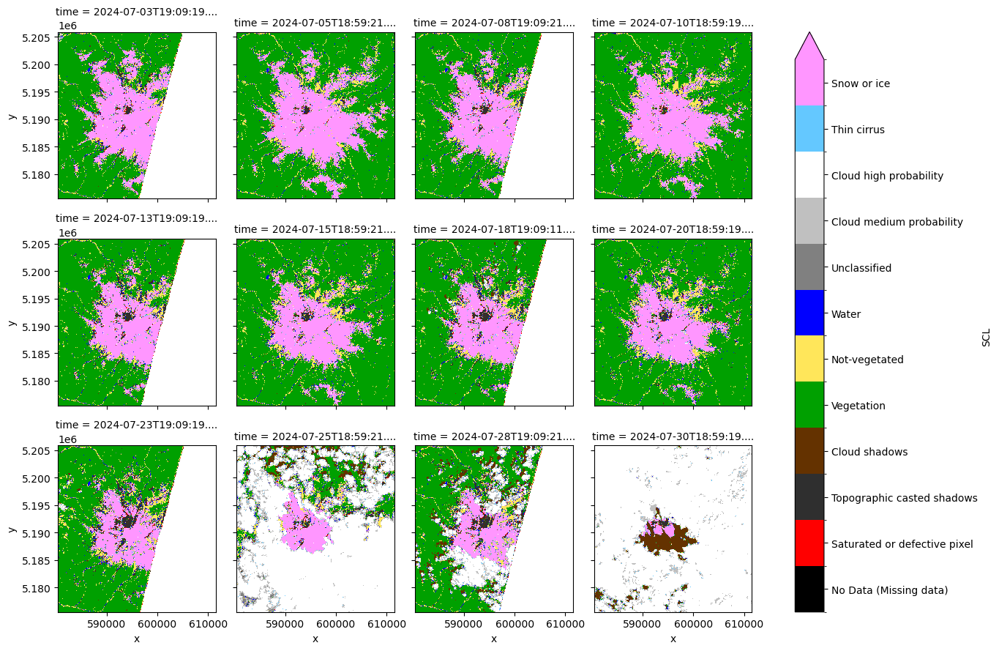

In [25]:
import matplotlib.colors
import matplotlib.ticker as mticker

# here's some colormap info
scl_class_info = {
    0: {"name": "No Data (Missing data)", "color": "#000000"},
    1: {"name": "Saturated or defective pixel", "color": "#ff0000"},
    2: {
        "name": "Topographic casted shadows",
        "color": "#2f2f2f",
    },  # (called 'Dark features/Shadows' for data before 2022-01-25)
    3: {"name": "Cloud shadows", "color": "#643200"},
    4: {"name": "Vegetation", "color": "#00a000"},
    5: {"name": "Not-vegetated", "color": "#ffe65a"},
    6: {"name": "Water", "color": "#0000ff"},
    7: {"name": "Unclassified", "color": "#808080"},
    8: {"name": "Cloud medium probability", "color": "#c0c0c0"},
    9: {"name": "Cloud high probability", "color": "#ffffff"},
    10: {"name": "Thin cirrus", "color": "#64c8ff"},
    11: {"name": "Snow or ice", "color": "#ff96ff"},
}

scl_cmap = plt.cm.colors.ListedColormap([info["color"] for info in scl_class_info.values()])
class_values = sorted(list(scl_class_info.keys()))
bounds = [(class_values[i] + class_values[i + 1]) / 2 for i in range(len(class_values) - 1)]
bounds = [class_values[0] - 0.5] + bounds + [class_values[-1] + 0.5]
norm = matplotlib.colors.BoundaryNorm(bounds, scl_cmap.N)
ticklabels = [item['name'] for item in scl_class_info.values()]

s2_ds['SCL'].plot.imshow(col='time',
                         col_wrap=4,
                         cmap=scl_cmap,
                         cbar_kwargs={"ticks": class_values, "format":mticker.FixedFormatter(ticklabels)},
                         norm=norm,
                         robust=True)

### Calculate and plot an NDVI time-series

In [26]:
ndvi_da = (s2_ds["B08"] - s2_ds["B04"]) / (s2_ds["B08"] + s2_ds["B04"])
ndvi_da

<xarray.DataArray (time: 12, y: 380, x: 389)> Size: 7MB
dask.array<truediv, shape=(12, 380, 389), dtype=float32, chunksize=(1, 380, 389), chunktype=numpy.ndarray>
Coordinates:
  * y            (y) float64 3kB 5.206e+06 5.206e+06 ... 5.176e+06 5.176e+06
  * x            (x) float64 3kB 5.804e+05 5.805e+05 ... 6.114e+05 6.115e+05
    spatial_ref  int32 4B 32610
  * time         (time) datetime64[ns] 96B 2024-07-03T19:09:19.024000 ... 202...

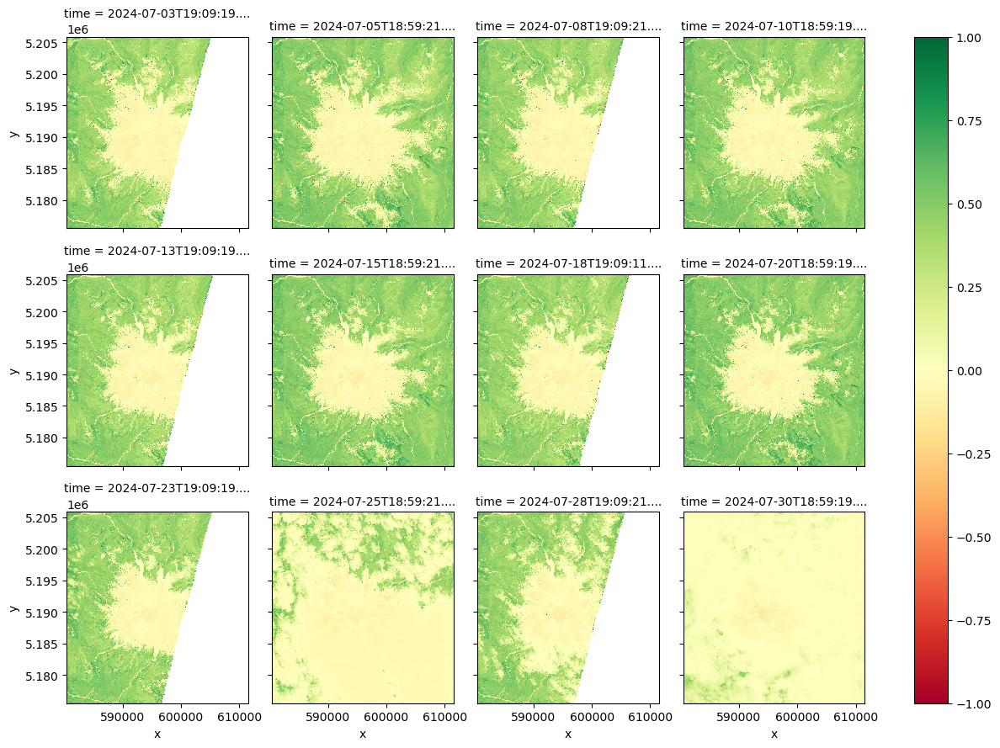

In [27]:
ndvi_da.plot.imshow(col='time',col_wrap=4,robust=True,cmap='RdYlGn',vmin=-1,vmax=1)

### Try again, masking out bad data according to the SCL

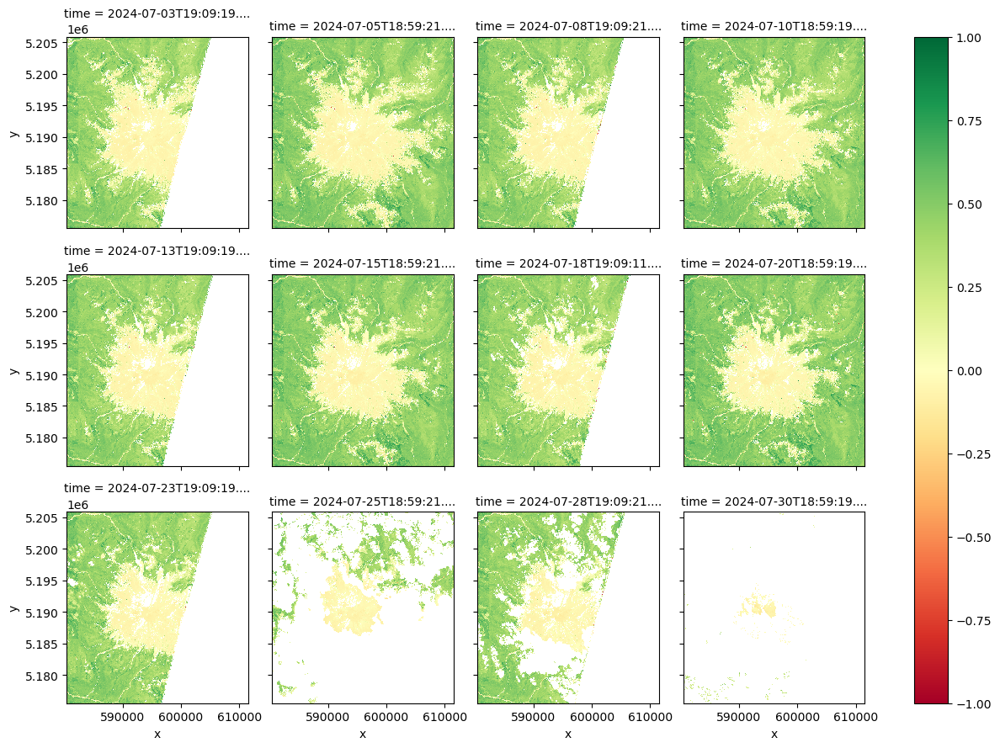

In [28]:
bad_scl = [0,1,2,3,8,9,10]

ndvi_masked_da = ndvi_da.where(~s2_ds['SCL'].isin(bad_scl)).compute() # What do you think compute does here? 

ndvi_masked_da.plot.imshow(col='time',col_wrap=4,robust=True,cmap='RdYlGn',vmin=-1,vmax=1)

### Plot a median NDVI image for July 2024

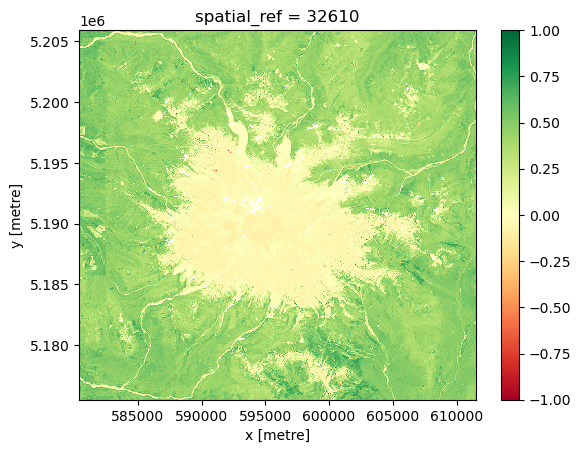

In [29]:
ndvi_masked_da.median(dim='time').plot.imshow(robust=True,cmap='RdYlGn',vmin=-1,vmax=1)

### Create a median NDVI time-series

In [30]:
# def not the best way to do this, but quick approximation
proportion_pixels_valid = ndvi_masked_da.count(dim=['x','y'])/ndvi_masked_da.count(dim=['x','y']).max()
proportion_pixels_valid

<xarray.DataArray (time: 12)> Size: 96B
array([0.63730512, 0.99736894, 0.65268564, 1.        , 0.6497117 ,
       0.99948918, 0.6696616 , 0.99463991, 0.63063649, 0.20557282,
       0.48157556, 0.01757774])
Coordinates:
    spatial_ref  int32 4B 32610
  * time         (time) datetime64[ns] 96B 2024-07-03T19:09:19.024000 ... 202...

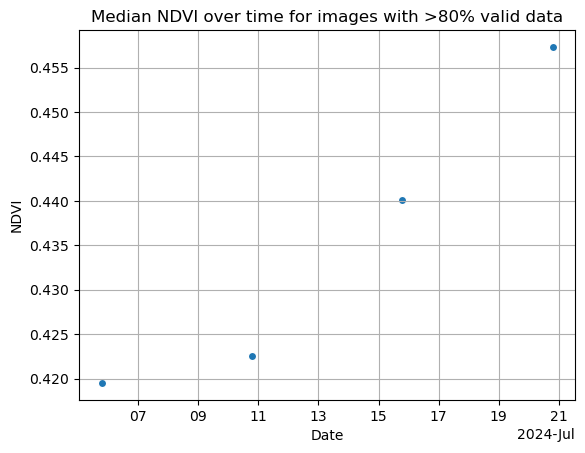

In [31]:
f,ax=plt.subplots()
ndvi_masked_da.where(proportion_pixels_valid > 0.8).median(dim=['x','y']).plot.scatter(ax=ax,x='time',y='data')
ax.set_title('Median NDVI over time for images with >80% valid data')
ax.set_ylabel('NDVI')
ax.set_xlabel('Date')
ax.grid(True)

### Great work! We covered APIs, STAC, and loading data from STAC into xarray datasets with odc-stac. Check out some other STAC catalogs, such as [Element84's Earth Search](https://github.com/Element84/earth-search) and [NASA's cmr-stac](https://github.com/nasa/cmr-stac), [(Data Discovery with CMR-STAC API)](https://nasa-openscapes.github.io/2021-Cloud-Hackathon/tutorials/02_Data_Discovery_CMR-STAC_API.html).
